## Computational Statistique TP2:

#### Samuel Bazaz Jazayeri

### Exercise 1 :

In [481]:
############
# Packages #
############
import time as t
import numpy as np

import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import rv_discrete, multivariate_normal
from scipy.special import logsumexp
from sklearn.cluster import KMeans

from scipy.stats.mstats import winsorize


import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from typing import Dict, Union, List, Tuple, Any

###################
# hyperparametres #
###################
seed = 0

np.random.seed(seed)

pio.renderers = "notebook"

data_path = "C://Users//samud//Bureau//Python code//MVA//Comput stat//data//WPP2022_GEN_F01_DEMOGRAPHIC_INDICATORS_COMPACT_REV1.xlsx"

In [2]:
##################
# functions ex 1 #
##################

def sample_discrete(dct_masse: Dict[Union[int, float], float], log: bool = False) -> Union[int, float, None]:
    """
    Sample a discrete random variable based on a probability mass function.

    This function takes a dictionary `dct_masse` representing a probability mass function (PMF)
    of a discrete random variable. It samples a value from the PMF according to the probabilities
    specified in the dictionary.

    Args:
        dct_masse (Dict[Union[int, float], float]): A dictionary representing the PMF, where keys are
            the possible values of the random variable, and values are their associated probabilities.
        log (bool, optional): If True, prints debugging information. Defaults to False.

    Returns:
        Union[int, float, None]: The sampled value from the random variable's distribution.
    """
    
    # on ordonne par les valeurs de la variable aléatoire
    dct_sorted = dict(sorted(dct_masse.items()))
    
    if log:
        print("sorted dict :", dct_sorted)
    
    # tire notre uniforme
    u = np.random.uniform()
    if log:
        print("uniforme trial : ", u)
    
    accu_proba = 0
    for x,p in dct_sorted.items():
        if log:
            print(f"x : {x}, p : {p}, accu_proba {accu_proba}")
        next_accu_proba = accu_proba + p
        if accu_proba == 0:
            if u <= next_accu_proba:
                return x
        else:
            if u > accu_proba and u <= next_accu_proba:
                return x
        
        accu_proba = next_accu_proba
    
    return None 
                

In [3]:
####################
# test ex1: 1 run  #
####################
dct_masse = {1:1/10, 3:2/10, 2:3/10, 6:2/10, 7:2/10 }
print("result : ",sample_discrete(dct_masse, log=True))

sorted dict : {1: 0.1, 2: 0.3, 3: 0.2, 6: 0.2, 7: 0.2}
uniforme trial :  0.5488135039273248
x : 1, p : 0.1, accu_proba 0
x : 2, p : 0.3, accu_proba 0.1
x : 3, p : 0.2, accu_proba 0.4
result :  3


In [4]:
########################
# test ex1: histogram  #
########################
n_points = 10000
dct_masse = {1:1/10, 3:2/10, 2:3/10, 6:2/10, 7:2/10 }

#sampling 
t1 = t.time()
lst_sim = [ sample_discrete(dct_masse, log=False) for k in range(n_points)]
t2 = t.time()

#histogram
fig1 = px.histogram(lst_sim, histnorm='probability density', title = f"<b>Histogram </b> for {n_points} points and masse function: <br> {dct_masse} <br> sampling time {np.round(t2-t1, 3)} s", template="plotly_dark")
fig1.show()

Comme l'échantillonnage sera une composante importante des prochaines fonctions, on va ici définir une fonction d'échantillonnage plus efficace.

In [5]:
#######################
# better sampler ex 1 #
#######################

def fast_sample_discrete(seed: int, dct_masse: Dict[Union[int, float], float], n_points: int) -> List[Union[int, float]]:
    """
    Fast sampling of discrete random variables based on a probability mass function.

    This function uses the SciPy library to efficiently sample discrete random variables from
    a given probability mass function using a random seed. It returns a list of sampled values.

    Args:
        seed (int): The random seed for reproducibility.
        dct_masse (Dict[Union[int, float], float]): A dictionary representing the probability mass function
            (PMF) of the discrete random variable, where keys are possible values, and values are their
            associated probabilities.
        n_points (int): The number of points (samples) to generate.

    Returns:
        List[Union[int, float]]: A list of sampled values from the distribution defined by the PMF.
    """
    return rv_discrete(seed = seed, values = (list(dct_masse.keys()), list(dct_masse.values()))).rvs(size=n_points)

#sampling 
t1 = t.time()
sampling = fast_sample_discrete(seed, dct_masse, n_points)
t2 = t.time()

#histogram
fig2 = px.histogram(sampling, histnorm='probability density', title = f"<b>Histogram using Scipy</b> for {n_points} points and masse function: <br> {dct_masse} <br> sampling time {np.round(t2-t1, 4)} s", template="plotly_dark")
fig2.show()

### Exercise 2 :

#### Gaussian Mixture Sampling et Visualisation d'un échantillon de test

In [6]:
################
#  GM sampler  #
################

def gmm_sample(
    seed: int,
    dct_masse_clusters: Dict[int, float],
    dct_clusters_para: Dict[int, Tuple[np.ndarray, np.ndarray]],
    n_points: int,
    dim: int = 2
) -> np.ndarray:
    """
    Generate samples from a Gaussian Mixture Model (GMM) using a given seed.

    This function generates random samples from a Gaussian Mixture Model (GMM) based on provided
    parameters for the clusters, cluster probabilities, and the number of points to generate.

    Args:
        seed (int): The random seed for reproducibility.
        dct_masse_clusters (Dict[int, float]): A dictionary representing the probability mass function
            (PMF) for cluster selection, where keys are cluster IDs and values are associated probabilities.
        dct_clusters_para (Dict[int, Tuple[np.ndarray, np.ndarray]]): A dictionary where keys are
            cluster IDs, and values are tuples containing cluster parameters. Each tuple consists of
            a mean vector and a covariance matrix.
        n_points (int): The number of points to generate.
        dim (int, optional): The dimensionality of the data (number of features). Defaults to 2.

    Returns:
        np.ndarray: An array containing the generated samples from the GMM.
    """
    cluster_sampling = fast_sample_discrete(seed, dct_masse_clusters, n_points)
    clusters, clust_count = np.unique(cluster_sampling, return_counts = True)
    sampling  = np.zeros((n_points, dim))
    s=0
    np.random.seed(seed)
    for i in range(len(clusters)):
        para = dct_clusters_para[clusters[i]]
        n = clust_count[i]
        sampling[s:s+n] = np.random.multivariate_normal(*para, size=n)
        s+=n
    return sampling

In [7]:
############################
#  sampling visualisation  #
############################

def sampling_viz(dct_masse_clusters, sampling, size=10,  levels=20):
    fig_sampling = plt.figure(figsize=(10, 10))
    sns.set(style='dark')
    plt.scatter(x = sampling[:,0], y = sampling[:,1], marker ="o", alpha = 0.1)
    sns.kdeplot(x = sampling[:,0], y = sampling[:,1], alpha = 1, levels = 20, cmap= "Blues" )
    plt.title(f"2D Gaussian Mixture sampling with {len(dct_masse_clusters)} clusters and {n_points} | n_points sampling time {np.round(t2-t1, 3)} s")
    fig_sampling.show()


On va utiliser l'échantillonnage suivant pour tester notre algorithme GMM

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\1251253642.py:11: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



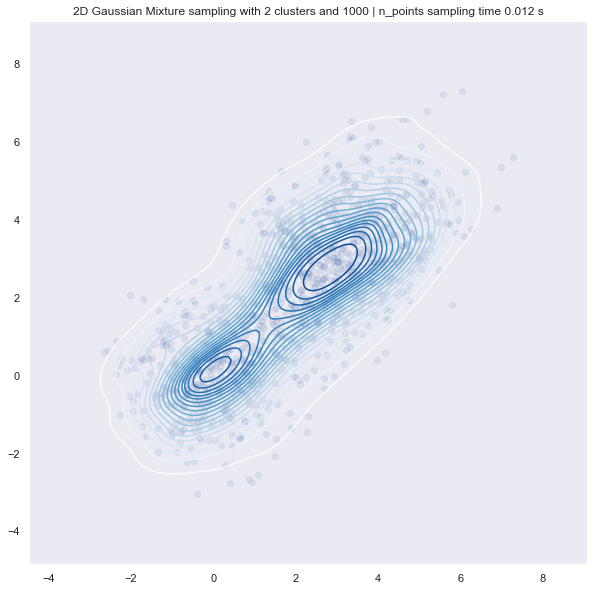

In [8]:
#######################
#  GM simple sampling #
#######################
n_points = 1000
dct_masse_clusters_0 = {1:1/3, 2:2/3}
dct_clusters_para_0 = {1: (
                        np.array([0,0]),
                        np.array([[1,0],
                                  [0,1]])
                        ),
                             
                     2:(
                        np.array([3,3]),
                        np.array([[2,1],
                                  [1,2]])          
                        ),
                    }
#sampling 
t1 = t.time()
sampling_0 = gmm_sample(seed, dct_masse_clusters_0, dct_clusters_para_0, n_points, dim = 2)
t2 = t.time()

sampling_viz(dct_masse_clusters_0, sampling_0, size=10,  levels=20)

### Initialisation

On commence par construire l'initialisation qui traduit les résultats d'un kmean en un one hot encoding. 

C:\Users\samud\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\852389118.py:30: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



                 0            1
count  1000.000000  1000.000000
mean      0.421000     0.579000
std       0.493967     0.493967
min       0.000000     0.000000
25%       0.000000     0.000000
50%       0.000000     1.000000
75%       1.000000     1.000000
max       1.000000     1.000000
     0  1
0    1  0
1    1  0
2    1  0
3    1  0
4    1  0
..  .. ..
995  1  0
996  1  0
997  0  1
998  1  0
999  0  1

[1000 rows x 2 columns]


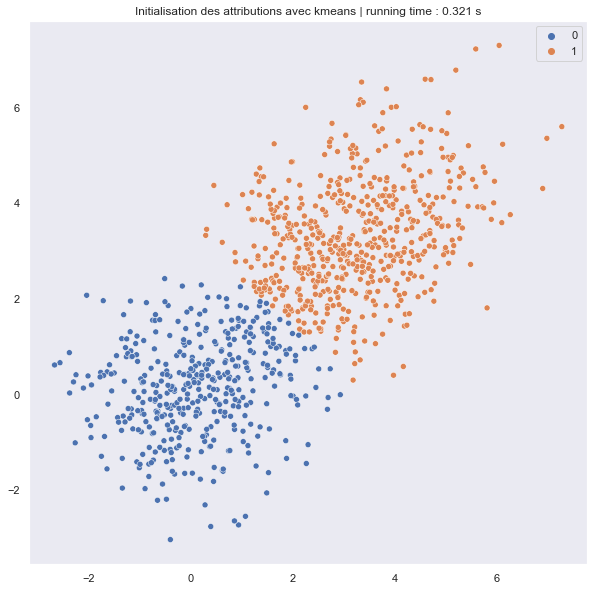

In [9]:
def init_attribution(
    seed: int,
    sampling: np.ndarray,
    n_clusters: int,
    plot: bool = False
) -> pd.DataFrame:
    """
    Initialize cluster assignments using K-Means clustering.

    This function performs K-Means clustering on the given data points and returns a one-hot encoded DataFrame
    representing the cluster assignments. It also provides an option to visualize the clustering results.

    Args:
        seed (int): The random seed for reproducibility.
        sampling (np.ndarray): An array containing the data points to be clustered.
        n_clusters (int): The number of clusters to form.
        plot (bool, optional): Whether to plot the clustering results. Defaults to False.

    Returns:
        pd.DataFrame: A one-hot encoded DataFrame representing the cluster assignments.
    """
    t1 = t.time()
    clustering = KMeans(n_clusters=n_clusters, random_state=seed, n_init="auto").fit(sampling).labels_
    t2 = t.time()
    if plot:
        fig5 = plt.figure(figsize=(10, 10))
        sns.set(style='dark')
        sns.scatterplot(x = sampling[:,0], y = sampling[:,1],  hue=clustering, ec=None)
        plt.title(f"Initialisation des attributions avec kmeans | running time : {np.round(t2-t1, 3)} s")
        fig5.show()
    return pd.get_dummies(clustering)

attribution = init_attribution(seed, sampling_0, 2, plot = True)
print(attribution.describe())
print(attribution)

In [10]:
def init_gm(seed: int, sampling: np.ndarray, n_clusters: int) -> Dict[str, Any]:
    """
    This function initializes a Gaussian Mixture Model (GMM) with cluster assignments and parameters.
    It calculates initial cluster assignments using K-Means clustering and creates an initial structure
    for the GMM.

    Args:
        seed (int): The random seed for reproducibility.
        sampling (np.ndarray): An array containing the data points to be clustered.
        n_clusters (int): The number of clusters to form.

    Returns:
        Dict[str, Any]: A dictionary containing the following keys:
            - 'x': The input data points.
            - 'tau': Initial cluster assignments represented as a one-hot encoded array.
            - 'theta': Initial parameters for the GMM.
    """
    dim = len(sampling[0])
    n_points = len(sampling)
    
    tau = init_attribution(seed, sampling, n_clusters)
    theta = np.zeros((n_clusters, dim+1, dim+1 ))
    return {"x": sampling, "tau": tau, "theta" : theta}


### mise à jours des variables et construction d'une itération de l'algorithme EM pour le GMM

In [145]:
def update_alpha_and_mu(data: Dict[str, Any], n: int, p: int, debug: bool = False) -> Tuple[np.ndarray, np.ndarray]:
    """
    Update parameters of a Gaussian Mixture Model (GMM).

    This function updates the parameters of a Gaussian Mixture Model (GMM), including the mixture coefficients
    and means. It uses the cluster assignments ('tau') and input data points ('x') to calculate the updated
    parameters.

    Args:
        data (Dict[str, Any]): A dictionary containing the data and parameters of the GMM.
        n (int): The total number of data points.
        p (int): The total number of clusters.
        debug (bool, optional): If True, print intermediate debugging information. Defaults to False.

    Returns:
        Tuple[np.ndarray, np.ndarray]: A tuple containing two numpy arrays:
            - The inverse of the sum of cluster assignments ('tau') for each cluster.
            - The updated means (mus) for each cluster.
    """
    sum_tau = np.sum(data["tau"])
    sum_tau_x = np.dot(data["tau"].T, data["x"])
    if debug:
        print("sum of tau \n", sum_tau)

    inverse_sum_tau = np.array(1/((1e-9) + sum_tau ))    
    
    data["theta"][:,2,0] = sum_tau / n
    if debug:
        print("\n alpha \n", data["theta"])
    
    mu = inverse_sum_tau.reshape((p, 1)) * sum_tau_x
    data["theta"][:,:2,0] = mu
    
    if debug:
        print("\n mu \n", data["theta"])
    
    return inverse_sum_tau, mu
    
def update_sigma_and_get_log_tau_unnormalized(data: Dict[str, Any], inverse_sum_tau: np.ndarray, mu: np.ndarray, n: int, p: int, debug: bool = False) -> np.ndarray:
    """
    Update the covariance matrices, and calculate the unnormalized log probabilities 
    for cluster assignments in a Gaussian Mixture Model (GMM).

    Args:
        data (Dict[str, Any]): A dictionary containing the GMM parameters and data.
        inverse_sum_tau (np.ndarray): The inverse of the sum of cluster assignments for each cluster.
        mu (np.ndarray): The means (mus) for each cluster.
        n (int): The total number of data points.
        p (int): The total number of clusters.
        debug (bool, optional): If True, print intermediate debugging information. Defaults to False.

    Returns:
        np.ndarray: An array containing the unnormalized log probabilities for cluster assignments.
    """
    log_tau_un = np.zeros((n,p))
    
    # on fait le tenseur des différences xi-muj:
    tens_x = np.repeat(data["x"], p, axis = 0).reshape((n,p,2))
    tens_x = np.transpose(tens_x, (1,0,2))
    tens_mu = np.repeat(mu, n, axis = 0).reshape((p,n,2))
    tens_dif = tens_x - tens_mu
    
    for j in range(p):
        accu = np.zeros((2,2))
        for i in range(n):
            dif_ij = tens_dif[j,i,:].reshape((2, 1))
            accu = accu + (data["tau"][j][i])*np.dot(dif_ij, dif_ij.T)
        data["theta"][j,:2,1:] = accu * inverse_sum_tau[j]
        if debug:
            print(f"\n sigma {j} \n", data["theta"])
        
        log_alpha_and_log_det_sigma =np.log(data["theta"][j,2,0])- (1/2)*np.multiply(* np.linalg.slogdet(data["theta"][j,:2,1:]))
        if debug:
            print(f"\n log_alpha_and_log_det_sigma {j} \n", log_alpha_and_log_det_sigma)
        
        for i in range(n):
            dif_ij = tens_dif[j,i,:].reshape((2, 1))
            inv_sigma = np.linalg.inv(data["theta"][j,:2,1:])    
            log_tau_un[i,j] = log_alpha_and_log_det_sigma -(1/2)*np.dot(dif_ij.T, np.dot(inv_sigma, dif_ij))
    
    return log_tau_un

def update_tau(data: Dict[str, Any], log_tau_un: np.ndarray, n: int, debug: bool = False) -> None:
    """
    Update the cluster assignment probabilities ('tau') in a Gaussian Mixture Model (GMM).

    This function updates the cluster assignment probabilities ('tau') in a Gaussian Mixture Model (GMM).
    It calculates the normalized probabilities based on the unnormalized log probabilities and assigns them to the data.

    Args:
        data (Dict[str, Any]): A dictionary containing the GMM parameters and data.
        log_tau_un (np.ndarray): Unnormalized log probabilities for cluster assignments.
        n (int): The total number of data points.
        debug (bool, optional): If True, print intermediate debugging information. Defaults to False.

    Returns:
        None
    """  
    if debug:
        var_tau = (-1)*data["tau"].copy()
        
    for i in range(n):
        log_sum_tau = logsumexp(log_tau_un[i,:])
        data["tau"].iloc[i,:] = np.exp(log_tau_un[i,:] - log_sum_tau)       
        
        if debug and i==0:
            print(f"\n tau {i} \n", data["tau"].iloc[i,:])
        if debug:
            var_tau.iloc[i,:] =var_tau.iloc[i,:] + data["tau"].iloc[i,:]
            
    if debug:
        fig_tau = px.histogram(data["tau"], title = f"<b>Histogram tau</b> for {n_points}",  template="plotly_dark")
        fig_tau.show()
        
        fig_var_tau = px.histogram(var_tau, title = f"<b>Histogram tau variations</b> for {n_points}",  template="plotly_dark")
        fig_var_tau.show()

        
def get_indicators(
    data: Dict[str, Any], 
    log_tau_un: np.ndarray, 
    n: int,
    p: int, 
    get_approx_likelyhood: bool = False,
    debug: bool = False) -> None:
    """
    Calculate evaluation indicators for a Gaussian Mixture Model (GMM).

    This function calculates evaluation indicators for a Gaussian Mixture Model (GMM), including the log-likelihood and Bayesian Information Criterion (BIC).

    Args:
        data (dict): A dictionary containing GMM-related data, including cluster assignments and parameters.
        log_tau_un (np.ndarray): Log-unnormalized cluster assignment probabilities.
        n (int): The number of data points.
        p (int): The number of clusters.
        get_approx_likelyhood (bool, optional): If True, calculate an approximate log-likelihood using normal probability density functions. Default is False.
        debug (bool, optional): If True, print debugging information. Default is False.

    Returns:
        None
    """
    lst_ind = ["log_likelyhood", "BIC"]
    if get_approx_likelyhood:
        data["log_likelyhood_approx"] = np.sum(log_tau_un*data["tau"]).sum()-n*np.log(2*np.pi)
        lst_ind = ["log_likelyhood_approx"] + lst_ind
    
    normal_pdf = np.zeros((p,n))
    for j in range(p):
        rv = multivariate_normal(mean = data["theta"][j,:2,0], cov = data["theta"][j,:2,1:] )
        normal_pdf[j,:] = rv.pdf(data["x"])

    alpha_dot_mat = np.dot(data["theta"][:,2,0], normal_pdf)
    data["log_likelyhood"] = np.sum( np.log(alpha_dot_mat) )
        
    data["BIC"] = (7/2)*p*np.log(n) - data["log_likelyhood"]
    if debug:
        for key in lst_ind:
            print(f"{key}: {data[key]}")
    
def gm_em_step(data: Dict[str, Any], get_approx_likelyhood: bool = False, debug: bool = False) -> Dict[str, Any]:
    """
    Perform one step of the Expectation-Maximization (EM) algorithm for Gaussian Mixture Model (GMM) estimation.

    Args:
        data (dict): A dictionary containing GMM-related data, including cluster assignments and parameters.
        get_approx_likelyhood (bool, optional): If True, calculate an approximate log-likelihood using normal probability density functions. Default is False.
        debug (bool, optional): If True, enable debugging mode to print intermediate results. Default is False.

    Returns:
        data (dict): An updated dictionary containing GMM-related data after one EM step.
    """
    n = len(data["tau"])
    p = len(data["theta"])
    inverse_sum_tau, mu = update_alpha_and_mu(data, n, p, debug = debug)
    log_tau_un = update_sigma_and_get_log_tau_unnormalized(data, inverse_sum_tau, mu, n, p, debug = debug)
    update_tau(data, log_tau_un, n, debug = debug)
    get_indicators(data, log_tau_un, n, p, get_approx_likelyhood = get_approx_likelyhood, debug = debug  ) 
    return data

# Test de la première étape
one_step_data = gm_em_step(init_gm(seed, sampling_0, 2),  get_approx_likelyhood=True, debug = True)

C:\Users\samud\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



sum of tau 
 0    421
1    579
dtype: int64

 alpha 
 [[[0.    0.    0.   ]
  [0.    0.    0.   ]
  [0.421 0.    0.   ]]

 [[0.    0.    0.   ]
  [0.    0.    0.   ]
  [0.579 0.    0.   ]]]

 mu 
 [[[0.1477266  0.         0.        ]
  [0.13230213 0.         0.        ]
  [0.421      0.         0.        ]]

 [[3.23084098 0.         0.        ]
  [3.28756765 0.         0.        ]
  [0.579      0.         0.        ]]]

 sigma 0 
 [[[0.1477266  1.1766501  0.17756886]
  [0.13230213 0.17756886 1.02812853]
  [0.421      0.         0.        ]]

 [[3.23084098 0.         0.        ]
  [3.28756765 0.         0.        ]
  [0.579      0.         0.        ]]]

 log_alpha_and_log_det_sigma 0 
 -0.9471235178309074

 sigma 1 
 [[[0.1477266  1.1766501  0.17756886]
  [0.13230213 0.17756886 1.02812853]
  [0.421      0.         0.        ]]

 [[3.23084098 1.44583819 0.41908375]
  [3.28756765 0.41908375 1.35699253]
  [0.579      0.         0.        ]]]

 log_alpha_and_log_det_sigma 1 
 -0.8365429362

log_likelyhood_approx: -3775.1348286588436
log_likelyhood: -3667.4751852250283
BIC: 3715.8294721779034


#### Visualisation d'une étape de clustering

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



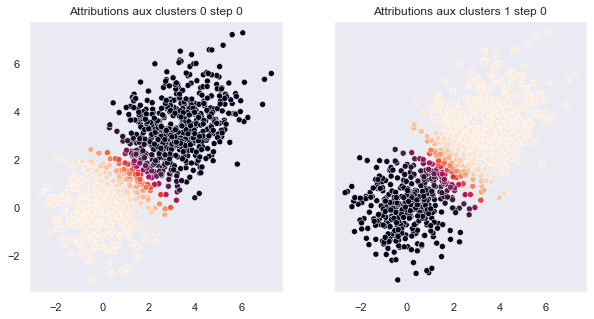

In [146]:
##############################
#  clustering visualisation  #
##############################

def gm_step_viz(
    sampling: np.ndarray,
    data: Dict[str, Any],
    step: int = 0
) -> None:
    """
    Visualize the clustering results for one step of the Gaussian Mixture Model (GMM) algorithm.

    This function creates visualizations to show the attributions of data points to clusters at a given step
    of the Gaussian Mixture Model (GMM) algorithm.

    Args:
        sampling (np.ndarray): The data points to be visualized.
        data (Dict[str, Any]): A dictionary containing GMM parameters and attributions.
        step (int, optional): The step of the algorithm for which to visualize attributions. Defaults to 0.

    Returns:
        None
    """
    p = len(data["theta"])
    sns.set(style='dark')
    fig_clustering, ax = plt.subplots(1, p, sharey=True, figsize=(p*5,5))

    for j in range(p):
        sns.scatterplot(x = sampling[:,0], y = sampling[:,1],  c=data["tau"].iloc[:,j], ec=None, ax=ax[j])
        ax[j].title.set_text(f"Attributions aux clusters {j} step {step}")
    fig_clustering.show()

gm_step_viz(sampling_0, one_step_data)

### GMM et visualisation des résultats de callibration

In [147]:
def reformat_gmm_output(data: Dict[str, Any], p: int) -> Tuple:
    """
    Reformat the output of a Gaussian Mixture Model (GMM) algorithm for better readability.

    This function takes the GMM model parameters and reformats them into more readable dictionaries.
    It provides the alpha (mixture coefficients) and the mean and covariance of each cluster.

    Args:
        data (Dict[str, Any]): A dictionary containing GMM model parameters.

    Returns:
        Tuple[Dict[int, float], Dict[int, Tuple[Tuple[float, float], Tuple[float, float]]]: 
            A tuple containing two dictionaries:
            - The first dictionary contains cluster indices as keys and alpha (mixture coefficients) as values.
            - The second dictionary contains cluster indices as keys and tuples as values.
              Each tuple contains two sub-tuples: (mean, covariance)
    """
    dct_m = {}
    dct_para = {}
    for j in range(p):
        dct_m[j] = np.round(data["theta"][j,2,0], 4)
        dct_para[j] = (np.round(data["theta"][j,:2,0], 2), np.round(data["theta"][j,:2,1:], 2))
    return dct_m, dct_para

def gaussian_mixture_em_no_stopping(
    seed: int, 
    sampling: np.ndarray, 
    n_clusters: int, 
    n_steps: int, 
    plot: bool = False, 
    debug: bool = False, 
    plot_period: int = 10
) -> Tuple:

    data = init_gm(seed, sampling, n_clusters)
    n = len(data["tau"])
    p = len(data["theta"])
    lst_ind = ["log_likelyhood_approx", "log_likelyhood", "BIC"]
    
    df_indicators = pd.DataFrame({ind:np.zeros(n_steps) for ind in lst_ind})
    break_step = -1
    for k in range(n_steps):
        if debug:
            print(f"\n_______step{k}______\n")
        gm_em_step(data, get_approx_likelyhood = True, debug = debug)
        df_indicators.loc[k,:] = list( map(data.get, lst_ind) ).copy()
        
        if plot and k%plot_period==0 or k==n_steps-1:
            gm_step_viz(sampling, data, step = k)
            
    if plot:
        for ind in lst_ind:
            fig_ind = px.line(df_indicators, 
                             y = ind, 
                             title = f"<b>{ind}</b> GMM {n_steps} steps {n_clusters}", 
                             template="plotly_dark")
            fig_ind.show()
        
    dct_m, dct_para = reformat_gmm_output(data, p)  
    return dct_m, dct_para, data["tau"], df_indicators

def compare_gmm_parameters(reg_dct_m, reg_dct_para, true_dct_m, true_dct_para):
    """
    Compare GMM parameters between the estimated and true GMM.

    This function compares the GMM parameters, including mixture coefficients (alpha), means, and covariances, between the estimated GMM and the true GMM for each cluster.

    Args:
        reg_dct_m (dict): A dictionary of estimated cluster indices as keys and alpha (mixture coefficients) as values.
        reg_dct_para (dict): A dictionary of estimated cluster indices as keys, and values as tuples containing the estimated cluster parameters, where each tuple includes the mean and covariance matrices.
        true_dct_m (dict): A dictionary of true cluster indices as keys and alpha (mixture coefficients) as values.
        true_dct_para (dict): A dictionary of true cluster indices as keys, and values as tuples containing the true cluster parameters, where each tuple includes the mean and covariance matrices.

    Returns:
        None
    """
    for j in range(len(reg_dct_m)):
        c = list(true_dct_m.keys())[j]
        print(f"\n## Cluster {j} ##")
        print(f"\nalpha {reg_dct_m[j]} true-alpha {true_dct_m[c]}")
        print(f"\nmu {reg_dct_para[j][0]} true-mu {true_dct_para[c][0]}")
        print(f"\nsigma \n{reg_dct_para[j][1]}")
        print(f"\ntrue-sigma \n{true_dct_para[c][1]}")
    

C:\Users\samud\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is cu

#### GM for 40 steps and 2 clusters | running time with plots 6.47 s ####

## Cluster 0 ##

alpha 0.3308 true-alpha 0.3333333333333333

mu [-0.13 -0.09] true-mu [0 0]

sigma 
[[ 0.95 -0.03]
 [-0.03  0.94]]

true-sigma 
[[1 0]
 [0 1]]

## Cluster 1 ##

alpha 0.6692 true-alpha 0.6666666666666666

mu [2.95 2.97] true-mu [3 3]

sigma 
[[1.84 0.91]
 [0.91 1.89]]

true-sigma 
[[2 1]
 [1 2]]


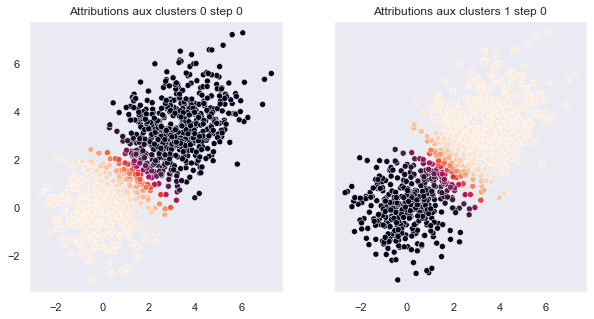

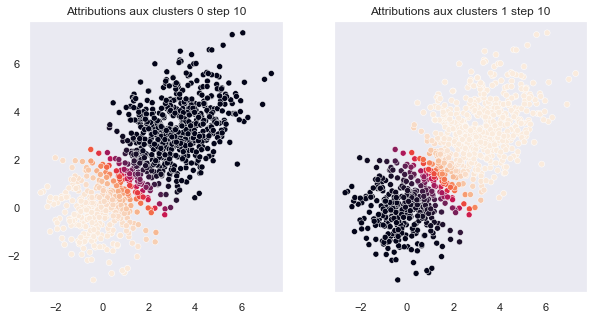

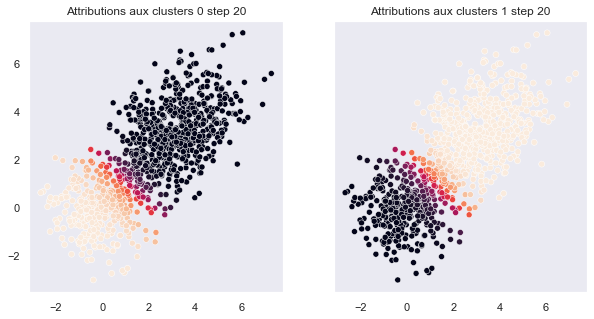

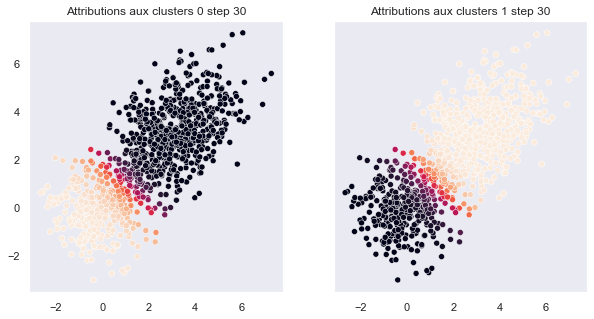

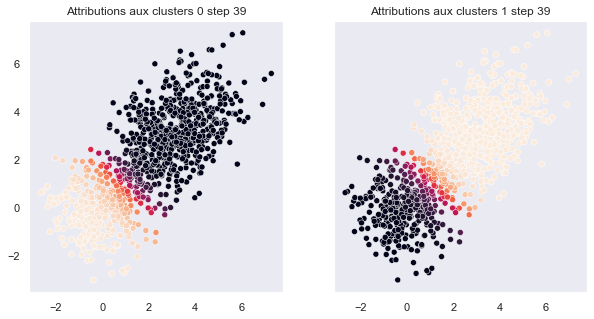

In [148]:
n_steps = 40
n_clusters = 2

t1 = t.time()
dct_m, dct_para, clustering, df_indicators = gaussian_mixture_em_no_stopping(seed, sampling_0, n_clusters, n_steps, plot=True, debug=False)
t2 = t.time()

print(f"#### GM for {n_steps} steps and {n_clusters} clusters | running time with plots {np.round(t2-t1, 3)} s ####")
compare_gmm_parameters(dct_m, dct_para, dct_masse_clusters_0, dct_clusters_para_0)

On observe que l'estimation de la log-likelyhood est trop imparfaite pour être utilisée comme proxi. On utilisera donc la plus couteuse Log-likelyhood directement.

In [149]:
def gaussian_mixture_em(
    seed: int, 
    sampling: np.ndarray, 
    n_clusters: int, 
    max_steps: int, 
    stop_thrs: Union[float, None] = 1e-3, 
    plot: bool = False, 
    debug: bool = False, 
    plot_period: int = 10
) -> Tuple:

    data = init_gm(seed, sampling, n_clusters)
    n = len(data["tau"])
    p = len(data["theta"])
    lst_ind = ["log_likelyhood", "BIC"]
    
    df_indicators = pd.DataFrame({ind:np.zeros(max_steps) for ind in lst_ind})
    break_step = -1
    for k in range(max_steps):
        if debug:
            print(f"\n_______step{k}______\n")
        gm_em_step(data, debug = debug)
        df_indicators.loc[k,:] = list( map(data.get, lst_ind) ).copy()
        
        if plot and k%plot_period==0 or k==max_steps-1:
            gm_step_viz(sampling, data, step = k)
            
        if k>0 and stop_thrs is not None:
            if abs(df_indicators.loc[k,"log_likelyhood"]-df_indicators.loc[k-1,"log_likelyhood"])<stop_thrs:
                break_step = k
                break
    
    df_indicators = df_indicators.iloc[:break_step, :]      
    if plot:
        fig_ind = px.line(df_indicators, 
                                     y = "log_likelyhood", 
                                     title = f"<b>Log-likelyhood</b> GMM {max_steps} max_steps {n_clusters} clusters stop_thrs : {stop_thrs}", 
                                     template="plotly_dark")
        fig_ind.show()
        
    dct_m, dct_para = reformat_gmm_output(data, p)  
    return dct_m, dct_para, data["tau"], df_indicators

C:\Users\samud\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



#### GM for 2 clusters max_steps = 40 steps and stop_thrs=0.01 | running time with plots 3.572 s ####

## Cluster 0 ##

alpha 0.3347 true-alpha 0.3333333333333333

mu [-0.12 -0.08] true-mu [0 0]

sigma 
[[ 0.96 -0.02]
 [-0.02  0.95]]

true-sigma 
[[1 0]
 [0 1]]

## Cluster 1 ##

alpha 0.6653 true-alpha 0.6666666666666666

mu [2.96 2.98] true-mu [3 3]

sigma 
[[1.82 0.89]
 [0.89 1.87]]

true-sigma 
[[2 1]
 [1 2]]


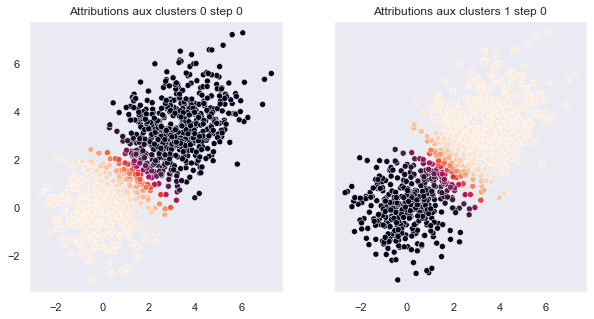

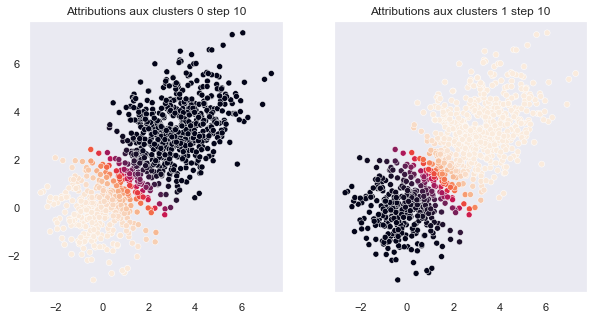

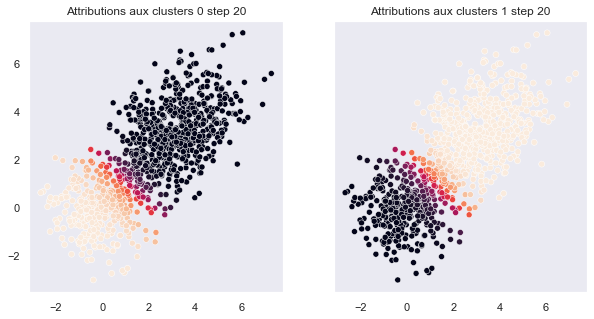

In [153]:
max_steps = 40
threshold = 1e-2
n_clusters = 2

t1 = t.time()
dct_m, dct_para, clustering, df_indicators = gaussian_mixture_em(seed, sampling_0, n_clusters, max_steps, threshold, plot=True, debug=False)
t2 = t.time()

print(f"#### GM for {n_clusters} clusters max_steps = {n_steps} steps and stop_thrs={threshold} | running time with plots {np.round(t2-t1, 3)} s ####")
compare_gmm_parameters(dct_m, dct_para, dct_masse_clusters_0, dct_clusters_para_0)

### Test avec un échantillonage plus complexe

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\1251253642.py:11: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



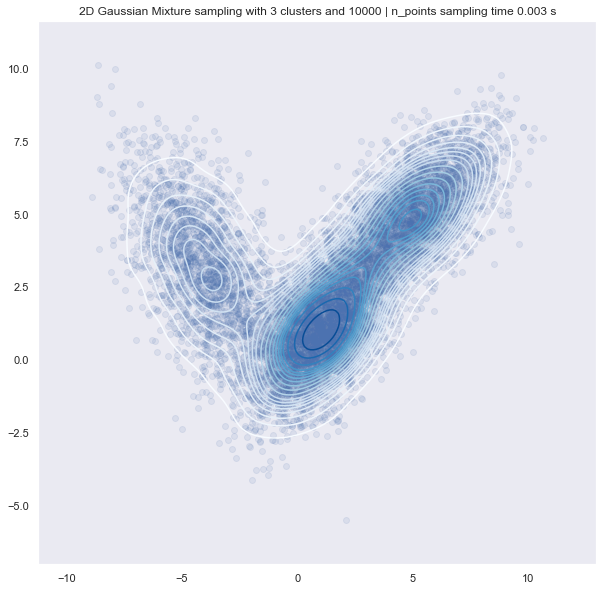

In [154]:
#######################
#  GM harder sampling #
#######################

n_points = 10000
n_clusters = 3
dct_masse_clusters_1 = {1:4/9, 3:2/9, 2:3/9}
dct_clusters_para_1 = {1: (
                        np.array([1,1]),
                        np.array([[2,1],
                                  [1,2]])
                        ),
                             
                     2:(
                        np.array([5,5]),
                        np.array([[3,1.5],
                                  [1.5,2]])          
                        ),
                     
                     3:(
                        np.array([-4,3]),
                        np.array([[3, -2],
                                  [-2, 4]])
                        )}

#sampling 
t1 = t.time()
sampling_1 = gmm_sample(seed, dct_masse_clusters_1, dct_clusters_para_1, n_points, dim = 2)
t2 = t.time()

sampling_viz(dct_clusters_para_1, sampling_1, size=10,  levels=20)

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



#### GM for 3 clusters max_steps = 40 steps and stop_thrs=0.01 | running time with plots 29.65 s ####

## Cluster 0 ##

alpha 0.4569 true-alpha 0.4444444444444444

mu [1.03 1.04] true-mu [1 1]

sigma 
[[2.01 1.02]
 [1.02 2.  ]]

true-sigma 
[[2 1]
 [1 2]]

## Cluster 1 ##

alpha 0.215 true-alpha 0.2222222222222222

mu [-3.98  3.05] true-mu [-4  3]

sigma 
[[ 2.74 -1.89]
 [-1.89  4.02]]

true-sigma 
[[ 3 -2]
 [-2  4]]

## Cluster 2 ##

alpha 0.3281 true-alpha 0.3333333333333333

mu [5.02 4.99] true-mu [5 5]

sigma 
[[2.94 1.49]
 [1.49 2.  ]]

true-sigma 
[[3.  1.5]
 [1.5 2. ]]


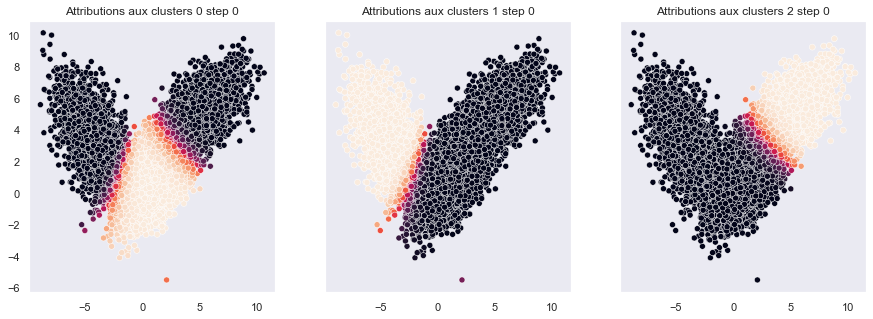

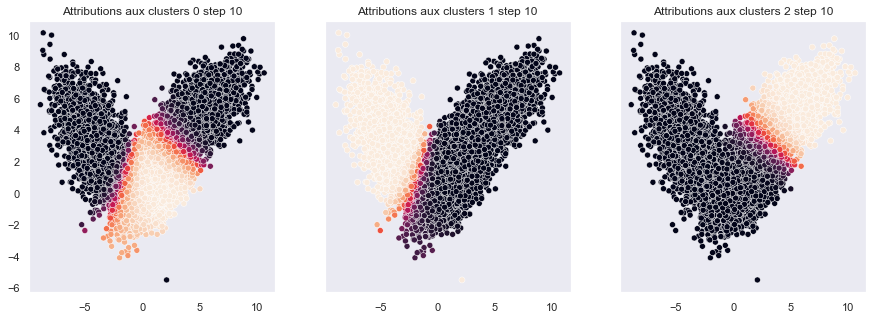

In [157]:
max_steps = 40
threshold = 1e-2
n_clusters = 3

t1 = t.time()
dct_m_1, dct_para_1, clustering, df_indicators = gaussian_mixture_em(seed, sampling_1, n_clusters, max_steps, threshold, plot=True, debug=False)
t2 = t.time()

print(f"#### GM for {n_clusters} clusters max_steps = {n_steps} steps and stop_thrs={threshold} | running time with plots {np.round(t2-t1, 3)} s ####")
compare_gmm_parameters(dct_m_1, dct_para_1, dct_masse_clusters_1, dct_clusters_para_1)

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which 

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which 

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which 

[44478.42055340501, 43919.140256873136, 43952.52367753861, 43982.82321436952]


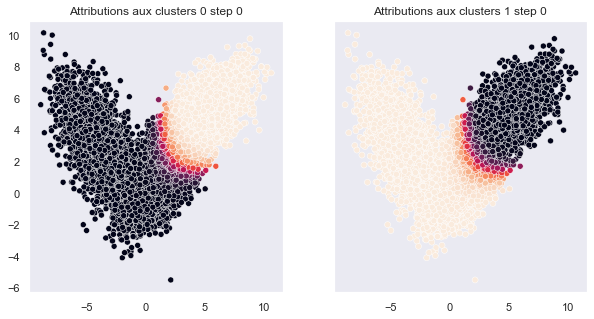

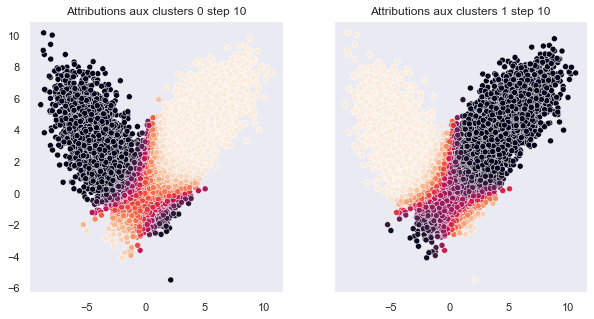

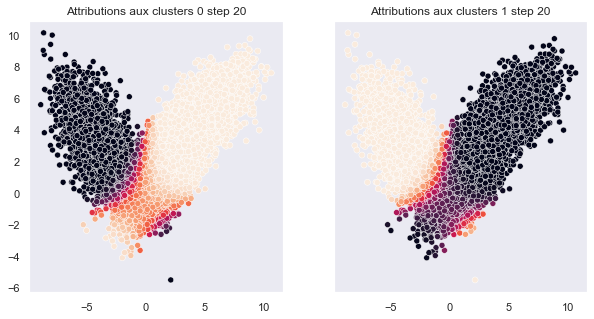

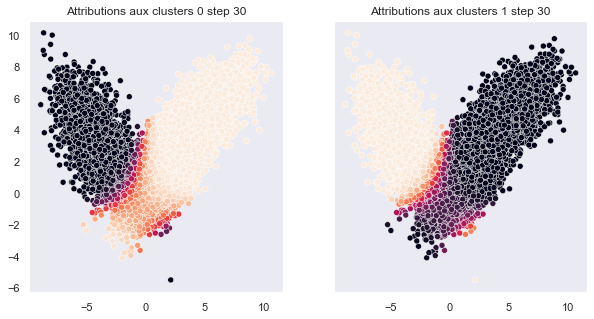

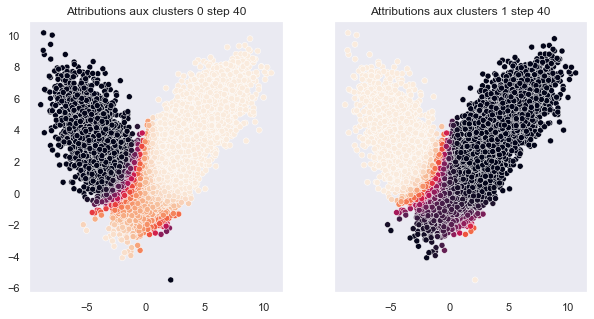

...

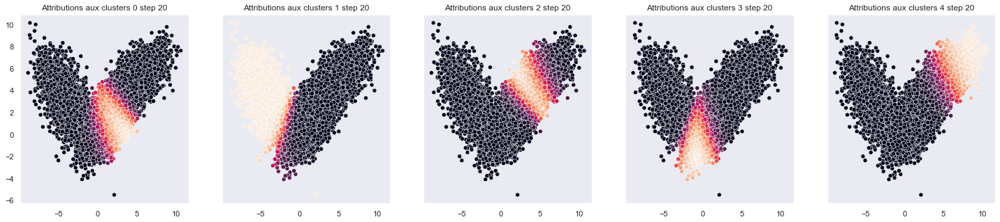

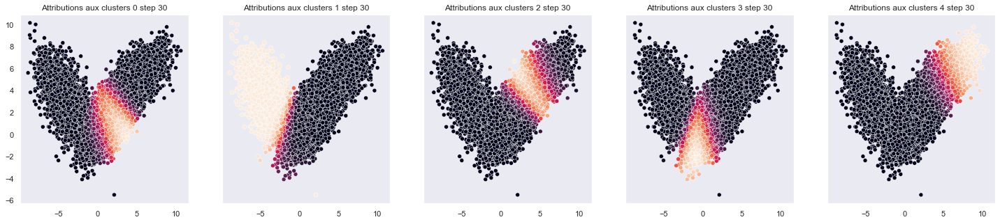

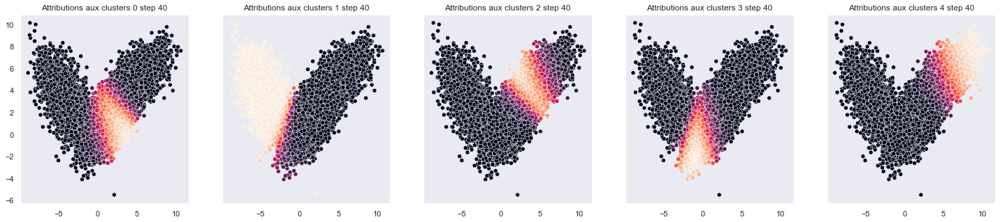

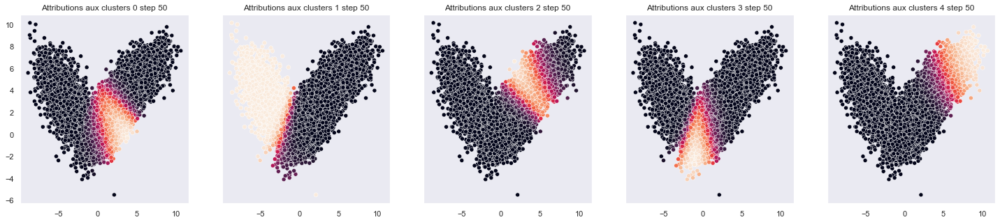

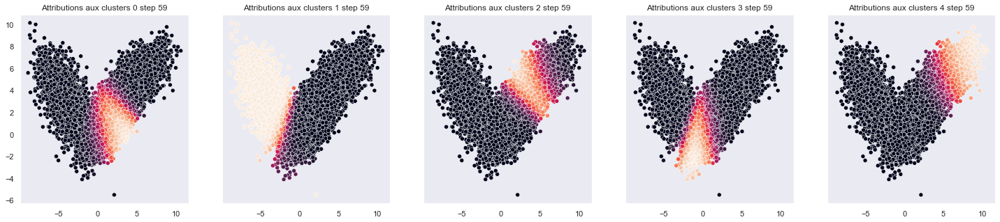

In [164]:
max_steps = 60
threshold = 3e-2

lst_bic = []
for n_clust in [2,3,4,5]:
    dct_m_1, dct_para_1, gm_clustering, df_indicators = gaussian_mixture_em(seed, sampling_1, n_clust, max_steps, threshold, plot=True, debug=False)
    lst_bic.append(df_indicators.iloc[-1]["BIC"])
print(lst_bic)

### Conclusion sur les données simulées

A partir des deux tests précédents, on peut déjà constater que la callibration fonctionne pour des données relativement simples : la vraisemblance converge et les paramètres obtenus sont proches de ceux qui ont générés les données. La taille de l'échantillon semble ensuite améliorer la regression car l'échantillon est plus proches d'un modèle Gaussien en terme de distribution. 
Concernant le BIC le cas n_clust=3 est le meilleur (minimale) pour notre distribution en V. 

### GMM sur des données réelles



In [45]:
######################
#  data exploration  #
######################
df = pd.read_excel(data_path, usecols = "Z, AH").dropna().iloc[1:] 
df.columns = ["birth rate", "death rate"]
#Z: Crude Birth Rate (births per 1,000 population), AH:Crude Death Rate (deaths per 1,000 population)


def df_nan_percent(df: pd.DataFrame) -> pd.DataFrame:
    """
    Calcule le pourcentage de valeurs manquantes dans chaque colonne d'un DataFrame.

    Args:
        df (pd.DataFrame): DataFrame contenant les données.

    Returns:
        pd.DataFrame: DataFrame contenant le pourcentage de valeurs manquantes pour chaque colonne.
    """
    part_nan = df.isnull().mean()
    perc_nan = pd.DataFrame(100 * part_nan.to_numpy())
    perc_nan.index = part_nan.index
    return perc_nan


print("\n---------Shape------------------\n", df.shape)
print("\n---------Types------------------\n", df.dtypes)
print("\n--------- 1 row-----------------\n", df.iloc[0, :])
print("\n---------describe---------------\n", df.describe())
print("\n---------nan percentage---------\n", df_nan_percent(df))
for col in df:
    unique_val = df[col].unique()
    if len(unique_val) < 20:
        print(f"\n---------{col} values----------")
        print(unique_val)


---------Shape------------------
 (20596, 2)

---------Types------------------
 birth rate    object
death rate    object
dtype: object

--------- 1 row-----------------
 birth rate    36.837
death rate    19.518
Name: 16, dtype: object

---------describe---------------
        birth rate death rate
count       20596      20596
unique      16246      12001
top           ...        ...
freq           76         76

---------nan percentage---------
               0
birth rate  0.0
death rate  0.0


In [159]:
#################
#  data format  #
#################

df.replace({"...": np.nan}, inplace=True)
df = df.astype("float")
df.head()

,birth rate,death rate
16,36.837,19.518
17,36.502,19.075
18,37.672,18.389
19,36.948,17.989
20,37.269,17.457


In [160]:
###############
#  box plots  #
###############

fig_box = px.box(df, template = "plotly_dark")
fig_box.show()

Une élimination d'outliers semble utile pour l'âge de décès. Intuitivement ces outliers sont dû aux famines et guerres qui ont touchés les populations étudiées, depuis les années 50. Leurs éliminations de l'étude n'est pas problématique vu que l'on s'intéresse ici aux transitions démographiques. 

In [63]:
##############
#  outliers  #
##############

q_hi  = df["death rate"].quantile(0.99)
df_filtered = df[(df["death rate"] < q_hi)]


Text(0.5, 1.0, ' Death rate / Birth rate 20596 points')

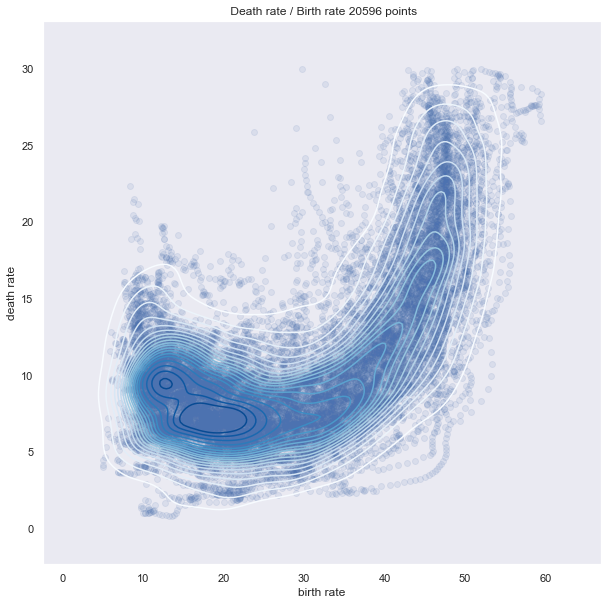

In [64]:
########################
#  data visualisation  #
########################

fig_sampling = plt.figure(figsize=(10, 10))
sns.set(style='dark')
plt.scatter(x = df_filtered["birth rate"], y = df_filtered["death rate"], marker ="o", alpha = 0.1)
sns.kdeplot(x = df_filtered["birth rate"], y = df_filtered["death rate"], alpha = 1, levels = 20, cmap= "Blues" )
plt.title(f" Death rate / Birth rate {len(df.index)} points")

Chaque point est associé à un pays ou une région à une année fixée. Le lien entre taux de naissance et taux de décès permet de discrimer une population avant la transition démographique (en haut à droite), après transition (en bas à gauche) et pendant la transition. Cette nomenclature est courante dans le champ médiatique et est associée à 3 clusters. Nous verrons avec ce qui suit, si d'autres nomenclatures plus fines peuvents être définies. 

Pour se faire nous utiliserons le BIC. Suite à plusieurs essais on remarque que la convergence de la vraisemblance est plus progressive ce qui nous incite à augmenter le stopping threshold et le nombre d'étapes maximal. 

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which 

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\3047122401.py:31: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which 

##BIC results## [131856.96466292633, 130584.41342684282, 130283.56401931086, 129834.16317859342]


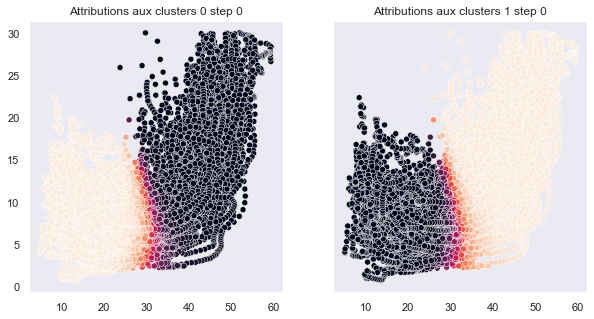

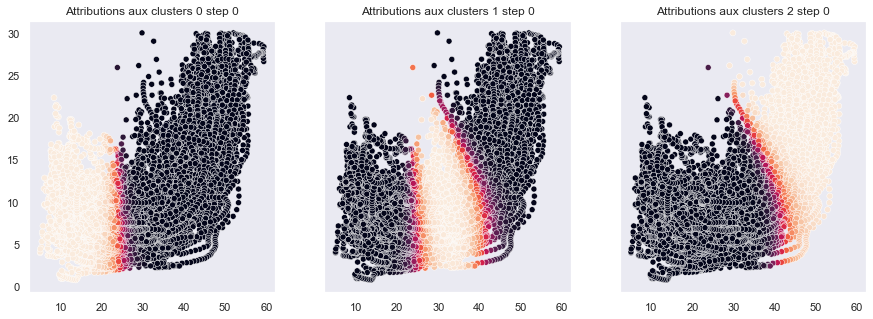

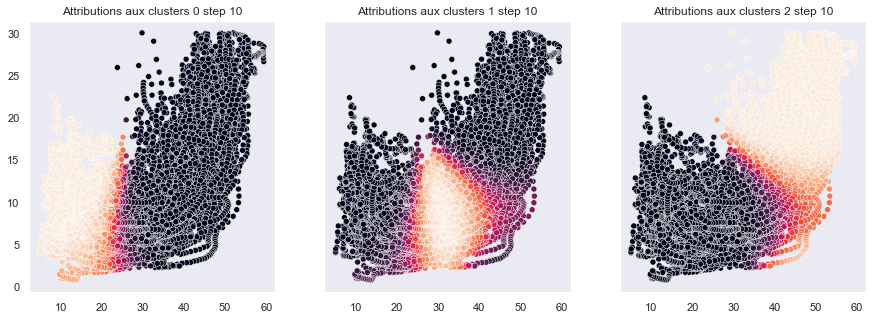

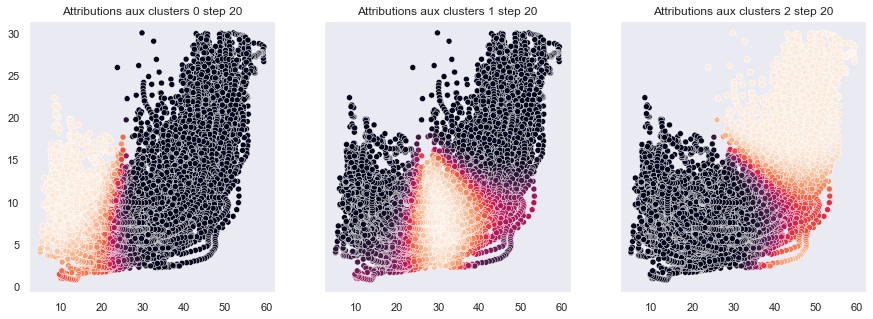

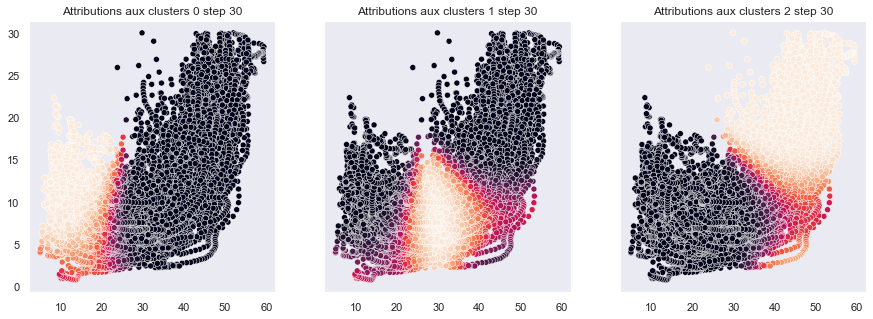

...

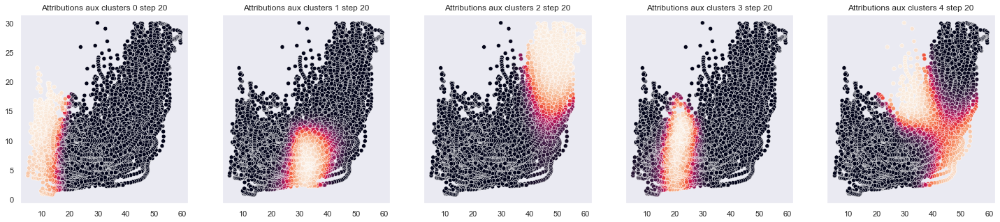

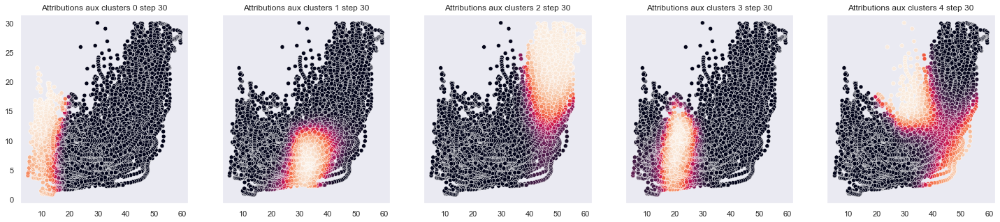

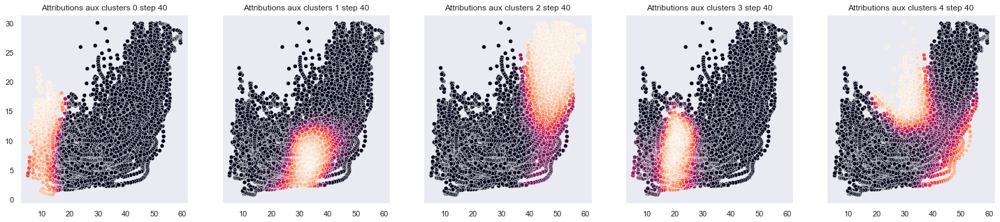

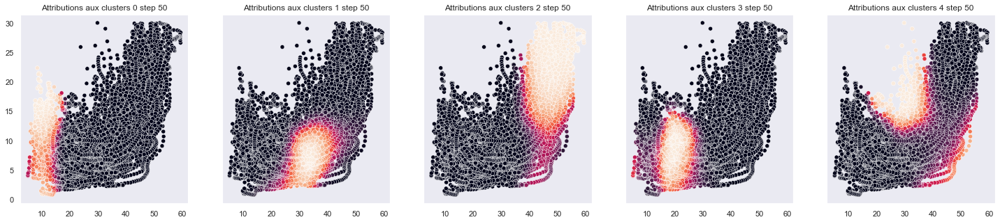

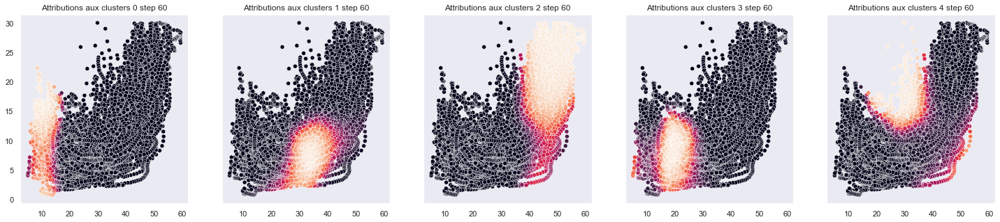

In [166]:
max_steps = 100
threshold = 1e-1

lst_bic = []
for n_clust in [2,3,4,5,6]:
    dct_m_1, dct_para_1, gm_clustering, df_indicators = gaussian_mixture_em(seed, df_filtered.to_numpy(), n_clust,  max_steps, threshold, plot=True, debug=False)
    lst_bic.append(df_indicators.iloc[-1]["BIC"])
print("##BIC results##", lst_bic)

Le critère d'information Bayésien semble nous indiquer de complexifier la nomenclature au maximum. 
Cependant il faut garder en mémoire que prendre un nombre réduit de clusters permet de simplifier les modèles et de réduire le nombre de cas à considérer. Ainsi il y a un thread off entre la simplification apporté par le clustering et la qualité de ce dernier.

### Exercise 3 :

### A:

#### Implémentations des fonctions

In [169]:
def f(x):
    if x<0:
        return 0
    return 2*np.sin((2*np.pi/3)*x)

print( f(-1),f(0),f(1), np.sqrt(3))

0 0.0 1.7320508075688774 1.7320508075688772


In [171]:
def p(x):
    if x<0:
        return 0
    return (x**(0.65))*np.exp(-(x**2)/2)
print( p(-1), p(0), p(1), 1/np.sqrt(np.exp(1)))

0 0.0 0.6065306597126334 0.6065306597126334


In [205]:
def q(x, mu = 0.8):
    rv = multivariate_normal(mean = mu, cov = [1.5] )
    return 2*rv.pdf(x)

print(q(0.8), 2/np.sqrt(3*np.pi))

0.6514700158705599 0.6514700158705599


In [206]:
def importance_weights_q_p(x, mu = 0.8):
    if x<0:
        return None
    return p(x)/q(x, mu = mu)

print(importance_weights_q_p(-1), importance_weights_q_p(0), importance_weights_q_p(1))

None 0.0 0.9435152416161623


#### Sampling selon q

In [209]:
def sample_q(n_points, mu = 0.8):
    return np.random.normal(loc = mu, scale = np.sqrt(1.5), size=n_points)

#histogram
mu=0.8
sampling_q = sample_q(10000, mu=mu)

mean = np.round(np.mean(sampling_q),3)
var = np.round(np.var(sampling_q),3)

fig1 = px.histogram(sampling_q, histnorm='probability density', title = f"<b>Histogram of q</b> for {n_points} points with mu={mu}<br> mean={mean} var={var} ", template="plotly_dark")
fig1.show()

#### 1) 

In [217]:
def importance_sampling_q_p(n_points, mu=0.8, fct = f, debug=False):
    f_aux = lambda x: importance_weights_q_p(x, mu=mu)*fct(x) if importance_weights_q_p(x) else None
    f_aux = np.vectorize(f_aux)
    importance_sampling = f_aux(sample_q(n_points))
    nan_mask = pd.isnull(importance_sampling)
    sampling_nonan = importance_sampling[~nan_mask]
    if debug:
        nan_count = np.count_nonzero(nan_mask)
        fig = px.histogram(sampling_nonan, histnorm='probability density', title = f"<b>Histogram of the importance sampling</b> for {n_points} points and mu={mu}<br> nan percentage = {100*nan_count/n_points}%", template="plotly_dark")
        fig.show()
    return np.mean(sampling_nonan)

n_points = 10000
print("mean(f(X)) estimation : ", importance_sampling_q_p(n_points, mu=0.8, fct = f, debug=True))

mean(f(X)) estimation :  0.5092993867791231


#### 2)

In [251]:
def plot_biais_variance(
    n_estimations_each,
    lst_npoints,
    plot_subtiltle = "mu = 0.8",
    f_estim = lambda n: importance_sampling_q_p(n)
):
    vf_estim = np.vectorize(f_estim)
    mat_accu = np.ones((n_estimations_each, len(lst_npoints)))
    for i in range(n_estimations_each):
        mat_accu[i,:] = vf_estim(np.array(lst_npoints))
        
    df_mean_var= pd.DataFrame({
        "npoints":lst_npoints,
        "mean": np.mean(mat_accu, axis=0),
        "var": np.var(mat_accu, axis=0)
    })

    fig = px.line(df_mean_var, 
                        x = "npoints",
                        y = ["mean", "var"], 
                        title = f"<b>Importance sampling estimator statistics</b><br>{plot_subtiltle}", 
                        template="plotly_dark",
                        log_x=True
                         )

    fig.show()
    

In [252]:
plot_biais_variance(
    40,
    [10, 100, 1000, 10000], 
    f_estim = lambda n: importance_sampling_q_p(n, mu = 0.8)
)

None


#### 3) mu=6

In [253]:
n_points = 10000
print("mean(f(X)) estimation : ", importance_sampling_q_p(n_points, mu=6, fct = f, debug=True))

mean(f(X)) estimation :  10558.675570483256


On remarque premièrement que les valeurs f(X) que l'on sample n'ont pas le même ordre de grandeur que précédemment.

In [254]:
# mu = 6
plot_biais_variance(
    40,
    [10, 100, 1000, 10000], 
    plot_subtiltle = "mu = 6",
    f_estim = lambda n: importance_sampling_q_p(n, mu = 6)
)

None


La variance de l'estimateur a explosé pour mu=6, ce qui est cohérent avec l'observation précédente.
Il ne reste plus qu'à comprendre pourquoi les valeurs des f(x) sont si différents.

In [259]:
n_points = 10000

df_weights = pd.DataFrame({})

for mu in [0.8, 6]:
    vf_weights = np.vectorize(lambda x: importance_weights_q_p(x, mu = mu))
    df_weights[f"{mu}"] = vf_weights(sample_q(n_points, mu=mu))
    
#histogram
fig = px.histogram(df_weights, histnorm='probability density', title = f"<b>Histogram of importance weights</b> for {n_points} points with mu={mu}<br> mean={mean} var={var} ", template="plotly_dark")
fig.show()

La queue de distribution semble être plus épaisse pour mu=6 ce qui fait apparaître des poids très grands. Cette forte variabilité des poids explique les valeurs plus hautes de la moyenne et de la variance. Ces valeurs extrêmes apparaissent quand p est proche de 0 et q en est éloigné. Or avec mu=6 ce cas de figure arrive souvent: les échantillons tirées sont très probablement au dessus de 4 et pour ces valeurs q est supérieur à 0.2 et p est proche de 0.
Pour y voir plus claire sur les distributions, regardons enfin les poids une fois que l'on a enlevé les valeurs extrêmes.

In [263]:
q_hi  = df_weights["6"].quantile(0.99)
df_weights_filtered = df_weights[(df_weights["6"] < q_hi)]

fig = px.histogram(df_weights_filtered, histnorm='probability density', title = f"<b>Histogram of importance weights</b> for {n_points} points with mu={mu}<br> mean={mean} var={var} ", template="plotly_dark")
fig.show()

On remarque des asymétries inversées entre les deux distributions qui s'interprête de la manière suivante: 
les réalisations sont probables pour q car sont tirés selon q, et sont improbable pour p dans le cas ou p et q sont éloignés (mu=6).

### C:

#### Initialisation

In [502]:
def construct_data(n_clusters: int, n_points) -> Dict[str, Any]:

    x = np.zeros((n_points, 5))
    tau = np.zeros((n_points, n_clusters))
    w_tau = np.zeros((n_points, n_clusters))
    theta = np.zeros((n_clusters, 6, 6 ))
    return {"x": x, "tau": tau, "w_tau":w_tau,"theta" : theta}


def init_data(n_clusters, n_points):
    data = construct_data(n_clusters, n_points)
    #alpha
    data["theta"][:,5,0] = (1/n_clusters)*np.ones((n_clusters))
    #sigma
    data["theta"][:,:5,1:] = 20*np.identity(5).copy()
    #mu
    
    #random prior ?
    data["theta"][:,0,0] = np.random.uniform(low=-4, high=4, size=None)
    data["theta"][:,1,0] = np.random.uniform(low=-4, high=4, size=None)
    
#     f_x2 = lambda x : -0.4*(x**2 -1)
#     f_x2 = np.vectorize(f_x2)

#     data["theta"][:,0,0] = np.linspace(-10,10,n_clusters)
#     data["theta"][:,1,0] = f_x2(data["theta"][:,0,0])
    return data
   

In [503]:
def sample_and_update_x(seed, data):
    
    n_cluster = len(data["theta"])
    n_points = len(data["x"])
    active_pop = data["theta"][:,5,0]>1e-3
    active_proba_un = data["theta"][active_pop,5,0]
    active_proba = active_proba_un/(1e-8+active_proba_un.sum())
    
    
    #sample on active populations only
    cluster_sampling =rv_discrete(
                        seed = seed, 
                        values = (np.arange(n_cluster)[active_pop], 
                                  active_proba)
                    ).rvs(size=n_points)
    clusters, clust_count = np.unique(cluster_sampling, return_counts = True)

    s=0
    np.random.seed(seed)
    for j in range(len(clusters)):
        n = clust_count[j]
        data["x"][s:s+n] = np.random.multivariate_normal(data["theta"][j,:5,0], data["theta"][j,:5,1:], size=n)
        s+=n


[[ -6.05545904 -38.70522128   2.18852466   5.01078952   4.17598662]
 [-12.18525977 -37.47553771  -0.33844501  -0.23080437   0.91812616]
 [ -9.67790878 -36.34814558   1.70173209   0.27207361   0.99250836]
 ...
 [ 10.55919741 -41.87371799   0.10264243   1.11946674   2.73770251]
 [  8.74893245 -36.19352173  -1.30966243   1.89302917  -0.23760239]
 [ 11.72170992 -37.92108518  -1.2536388   -3.93607515   0.97728867]]


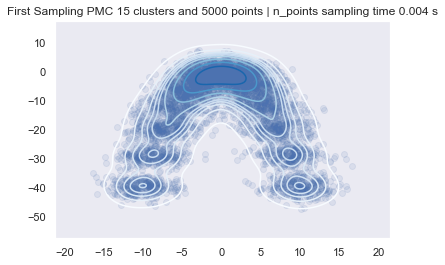

In [495]:
n_clusters = 15
n_points = 5000

data_test = init_data(n_clusters, n_points)
t1 = t.time()
sample_and_update_x(seed, data_test)
t2 = t.time()
print(data_test["x"])

sns.set(style='dark')
plt.scatter(x = data_test["x"][:,0], y = data_test["x"][:,1], marker ="o", alpha = 0.1)
sns.kdeplot(x = data_test["x"][:,0], y = data_test["x"][:,1], alpha = 1, levels = 10, cmap= "Blues" )
plt.title(f"First Sampling PMC {n_clusters} clusters and {n_points} points | n_points sampling time {np.round(t2-t1, 3)} s")
plt.show()

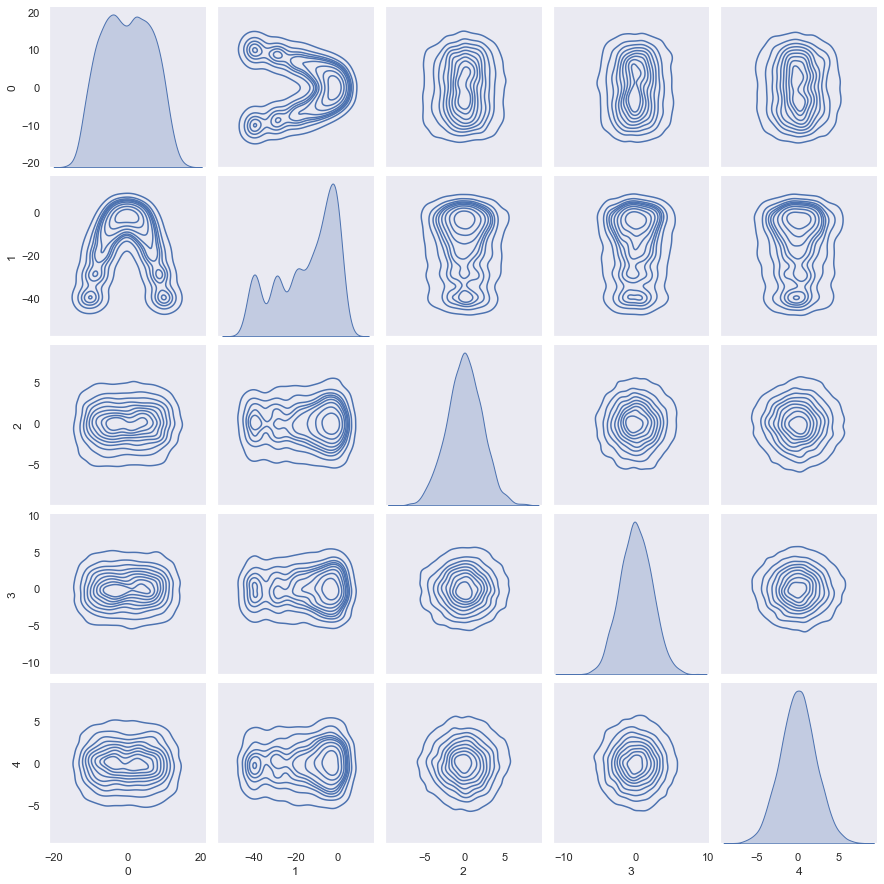

In [486]:
sns.pairplot(pd.DataFrame(data_test["x"]), kind="kde")

In [500]:
def pmc_get_tau_un(data, n,p):
    log_tau_un = np.zeros((n,p))
    for j in range(p):
        #pour les populations non éteintes
        if data["theta"][j,5,0] > 1e-2: 
            log_alpha_and_log_det_sigma =np.log(data["theta"][j,5,0])- (1/2)*np.multiply(* np.linalg.slogdet(data["theta"][j,:5,1:]))
            for i in range(n):
                dif_ij = (data["x"][i,:]-data["theta"][j,:5,0]).reshape((5, 1))
                inv_sigma = np.linalg.inv(data["theta"][j,:5,1:])    
                log_tau_un[i,j] = log_alpha_and_log_det_sigma -(1/2)*np.dot(dif_ij.T, np.dot(inv_sigma, dif_ij))
    
    return log_tau_un

def pmc_update_tau(data: Dict[str, Any], log_tau_un: np.ndarray, n: int, debug: bool = False) -> None:
    """
    Update the cluster assignment probabilities ('tau') in a Gaussian Mixture Model (GMM).

    This function updates the cluster assignment probabilities ('tau') in a Gaussian Mixture Model (GMM).
    It calculates the normalized probabilities based on the unnormalized log probabilities and assigns them to the data.

    Args:
        data (Dict[str, Any]): A dictionary containing the GMM parameters and data.
        log_tau_un (np.ndarray): Unnormalized log probabilities for cluster assignments.
        n (int): The total number of data points.
        debug (bool, optional): If True, print intermediate debugging information. Defaults to False.

    Returns:
        None
    """  
    for i in range(n):
        log_sum_tau = logsumexp(log_tau_un[i,:])
        data["tau"][i,:] = np.exp(log_tau_un[i,:] - log_sum_tau)       
            
    if debug:
        fig_tau = px.histogram(data["tau"], title = f"<b>Histogram tau</b> for {n_points}",  template="plotly_dark")
        fig_tau.show()

def pmc_banana_measure(x):  
    
    x_bananed = x.copy()
    x_bananed[1] = x_bananed[1]+0.4*(x_bananed[0]**2 - 1) 
    rv = multivariate_normal(mean = np.zeros(5), cov = np.identity(5) )
    return rv.pdf(x_bananed)
    
def importance_weights_funct(x, data):
    accu = 0
    for j in range(len(data["theta"])):
        #populations non éteintes:
        if data["theta"][j,5,0] > 1e-2:       
            accu +=data["theta"][j,5,0]*multivariate_normal(
                mean = data["theta"][j,:5,0], 
                cov = data["theta"][j,:5,1:]
            ).pdf(x)
            
    if accu == 0:
        return 0
    return pmc_banana_measure(x)/(1e-3 + accu)

def pmc_update_wtau(data, n, p):
    importance_weights = np.zeros(n)
    for i in range(n):
        importance_weights[i] = importance_weights_funct(data["x"][i,:], data)
    importance_weights = winsorize(importance_weights)
    norm_weights = importance_weights/(1e-4 + np.mean(importance_weights))
    mat_normw = np.repeat(norm_weights, p).reshape((n,p)) 
    data["wtau"] = np.multiply(mat_normw, data["tau"])

    
def pmc_update_alpha_and_mu(data: Dict[str, Any], n: int, p: int, debug: bool = False) -> Tuple[np.ndarray, np.ndarray]:

    sum_tau = np.sum(data["wtau"], axis=0)
    sum_tau_x = np.dot(data["wtau"].T, data["x"])
    inverse_sum_tau = np.array(1/((1e-9) + sum_tau ))    
    data["theta"][:,5,0] = sum_tau / n
    mu = inverse_sum_tau.reshape((p, 1)) * sum_tau_x
    data["theta"][:,:5,0] = mu
    return inverse_sum_tau, mu
    
def pmc_update_sigma(data: Dict[str, Any], inverse_sum_tau: np.ndarray, mu: np.ndarray, n: int, p: int, debug: bool = False) -> np.ndarray:
    for j in range(p):
        #populations non éteintes:
        if data["theta"][j,5,0] > 1e-2:     
            accu = np.zeros((5,5))
            for i in range(n):
                dif_ij = (data["x"][i,:]-mu[j,:]).reshape((5, 1))
                accu = accu + (data["wtau"][i,j])*np.dot(dif_ij, dif_ij.T)
            data["theta"][j,:5,1:] = accu * inverse_sum_tau[j]
    
def pmc_step(data: Dict[str, Any]) -> Dict[str, Any]:

    n = len(data["tau"])
    p = len(data["theta"])
    log_tau_un = pmc_get_tau_un(data, n,p)
    pmc_update_tau(data, log_tau_un, n)
    pmc_update_wtau(data, n, p)
    inverse_sum_tau, mu = pmc_update_alpha_and_mu(data, n, p)
    pmc_update_sigma(data, inverse_sum_tau, mu, n, p)
    # lissage et corrections des probas
    data["theta"][:,5,0] = data["theta"][:,5,0]/(1e-8 + data["theta"][:,5,0].sum())
    data["theta"] = np.round(data["theta"], 4)


# Test de la première étape
#one_step_data = gm_em_step(init_gm(seed, sampling_0, 2),  get_approx_likelyhood=True, debug = True)

In [488]:
n_clusters = 20
n_points = 1000

data_test = init_data(n_clusters, n_points)
sample_and_update_x(seed, data_test)
pmc_step(data_test)

print(data_test["theta"][:,5,0].sum())


1.0


### PMC Banana shape

In [492]:
def pmc_step_viz(
    data: Dict[str, Any],
    step: int = 0
) -> None:
    p = len(data["theta"])
    sns.set(style='dark')
    fig_clustering, ax = plt.subplots(1, p, sharey=True, figsize=(p*5,5))

    for j in range(p):
        sns.scatterplot(x = data["x"][:,0], y = data["x"][:,1],  c=data["tau"][:,j], ec=None, ax=ax[j])
        ax[j].title.set_text(f"Attributions aux clusters {j} step {step}")
    fig_clustering.show()



def pmc_banana(
    seed: int, 
    n_clusters: int, 
    n_points,
    max_steps: int, 
    resampling_period = 10,
    plot: bool = False, 
    plot_period: int = 5
) -> Tuple:
    
    data = init_data(n_clusters, n_points)
    for k in range(max_steps):
        if k%resampling_period==0:
            sample_and_update_x(seed, data)
        #print(data["theta"][:,:5,1:])
        if data["theta"][:,5,0].sum()<1e-2:
            print("!!!populations éteintes!!!!")
            break
        pmc_step(data)
        if plot and k%plot_period==0 or k==max_steps-1:
            pmc_step_viz(data, step = k)
            
    dct_m, dct_para = reformat_gmm_output(data, p)  
    return dct_m, dct_para, data["tau"], df_indicators

In [ ]:

# n_clusters = 20
# n_points = 5000
# max_steps = 1000

n_clusters = 15
n_points = 5000
max_steps = 100
resampling_period = 20


pmc_banana(
    seed, 
    n_clusters, 
    n_points,
    max_steps, 
    resampling_period,
    plot=True, 
    plot_period= 10
)

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\4252005663.py:12: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\4252005663.py:12: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\4252005663.py:12: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

C:\Users\samud\AppData\Local\Temp\ipykernel_3628\4252005663.py:12: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.

